This notebook discusses mainline stellar nucleosynthesis via Jupyter technology.  As you read through the text, you can execute the code blocks.  You can change input (for example, choose different axis ranges or scaling or select different species to show in the plots).  You can right-click or control-click on figures to save them.  If your current version gets corrupted, don't worry.  Simply quit and download a new copy from GitHub, or start up a new version on Google Colab or Binder.

## Table of Contents:

[Introduction](#introduction)<br/>
[Preliminaries](#preliminaries)<br/>
[Model](#model)<br/>
[Burning stages](#stages)<br/>

> [Hydrogen burning](#hydrogen)<br/>
> [Helium burning](#helium)<br/>
> [Carbon burning](#carbon)<br/>
> [Neon burning](#neon)<br/>
> [Oxygen burning](#oxygen)<br/>
> [Silicon burning](#silicon)<br/>

[Retrospective](#retrospective)<br/>

<a id='introduction'></a>
# Introduction

Nuclear burning in a star proceeds through a series  of fairly well-defined and certainly well-studied burning [stages](https://en.wikipedia.org/wiki/Stellar_nucleosynthesis) .  This notebook introduces those burning stages through the results of [single-zone network calculations](https://github.com/mbradle/mainline-nucleosynthesis).  The calculations were run at constant temperature and density for a certain duration.  The final abundances of the particular burning stage were used as the initial abundances of the next burning stage.

A stable star is in [hydrostatic equilibrium](https://en.wikipedia.org/wiki/Hydrostatic_equilibrium) such that gravitational contraction is balanced by a pressure gradient from the inside of the star to its surface.  As the star radiates energy, it loses that pressure support.  Nuclear reactions release binding energy and maintain the required pressure for hydrostatic equilibrium.  Once the burning has exhausted the fuel available for a given burning stage, the star contracts and heats up until the next available fuel ignites and the next buring stage begins.  This sequence occurs until there is no available fuel, or, more precisely, the nuclei present cannot be rearranged into other species and release energy.

This notebook explores some details of the mainline stellar burning stages.  It downloads a particular model, a set of burning sequence calculations, from [OSF](https://osf.io/qa2cb/).  It then uses [wnutils](https://wnutils.readthedocs.io) to read, graph, and animate the data for the given model.

<a id='preliminaries'></a>
# Preliminaries

To begin, we import packages.  First, import the necessary packages and download the necessary data.  Installing wnutils will automatically also install numpy and matplotlib.

In [1]:
import sys
!{sys.executable} -m pip install --quiet wnutils

The next step is to import the packages to check for and retrieve the data:

In [2]:
import os, io, requests
from lxml import etree

This notebook uses [wnutils](https://wnutils.readthedocs.io) to analyze the nucleosyntheis [XML](https://www.w3.org/TR/REC-xml/) output, so the next code block imports that package.  It also imports the matplotlib and numpy packages as well as a routine to display animations.

In [3]:
import wnutils.xml as wx
import wnutils.multi_xml as mx
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import HTML

Define a routine to print the properties of burning stage.

In [4]:
def print_props(xml):
    props = xml.get_properties_as_floats(['time', 't9', 'rho'])
    print('For the calculation, the duration, temperature, and density were:')
    print('   time (yr) = {0:.2e}'.format(props['time'][len(props['time'])-1] / 3.15e7))
    print('   T (K) = {:.2e}'.format(props['t9'][len(props['t9'])-1] * 1.e9))
    print('   mass density (g/cc) = {:.2e}'.format(props['rho'][len(props['rho'])-1]))

Finally define a routine to compute the electron fraction and nuclear binding energy per nucleon at particular points in a burning stage.

In [5]:
def stages_globals(xmls, zone_xpath):
    ye = []
    b = []
    for xml in xmls:
        y = xml.get_all_abundances_in_zones(zone_xpath = zone_xpath)
        nucs = xml.get_nuclide_data()
        dp = nucs['h1']['mass excess'] 
        dn = nucs['n']['mass excess']
        bind = 0
        ye_t = 0
        for nuc in nucs:
            z = nucs[nuc]['z']
            n = nucs[nuc]['n']
            a = nucs[nuc]['a']
            bind += (z * dp + n * dn - nucs[nuc]['mass excess']) * y[0, z, n]
            ye_t += z * y[0, z, n] / a
        ye.append(ye_t)
        b.append(bind)
        
    return ye, b

<a id='model'></a>
# Model

In this section, you choose the model for study.  This cell prints out the names of the available models.

In [6]:
models_xml = etree.parse(io.BytesIO(requests.get('https://osf.io/3utpw//download').content))

models = (models_xml.getroot()).xpath("model")

for m in models:
    print((m.xpath("//name"))[0].text, ":", (m.xpath("//short_desc"))[0].text)

model1 : Default input.


Choose the model.  Save the url to a file.

In [7]:
model = 'model1'

xpath_str = "model[name = " + "'{}'".format(model) + "]"
f = open('url.txt', "w")
f.write((((models_xml.getroot()).xpath(xpath_str))[0].xpath("//url"))[0].text)
f.close()

The following code block next checks whether the data for the model exist locally, and, if not, retrieves and unpacks them from [OSF](https://osf.io/r6yax/).  If you would like to suppress the download statistics, add a *-s* to the curl command after the *-L*.

In [8]:
if not os.path.exists(model):
    !curl -o model.tar.gz -J -L `cat url.txt`
    !tar zxf model.tar.gz

<a id='stages'></a>
# Burning stages

<a id='hydrogen'></a>
## Hydrogen burning

The first nucleosynthesis stage in the star's life is hydrogen burning.  Begin by reading in the data and printing the conditions for the model.

In [9]:
h = wx.Xml(model + '/h_burning/out.xml')
print_props(h)

For the calculation, the duration, temperature, and density were:
   time (yr) = 1.00e+09
   T (K) = 2.50e+07
   mass density (g/cc) = 1.50e+01


In hydrogen burning, the initial $^1$H burns to $^4$He.  For stars greater than about 1.3 times the mass of the Sun, this occurs via [CNO cycling](https://en.wikipedia.org/wiki/CNO_cycle).  Note that the mass fraction of a species is the fraction of the total mass of the system that is in that species.  It is thus the grams of that species per gram of material.  Core hydrogen burning occurs largely non-convectively in stars that leave behind white dwarf remnants.  Typically about 10% of the star (by mass) undergoes core hydrogen burning.

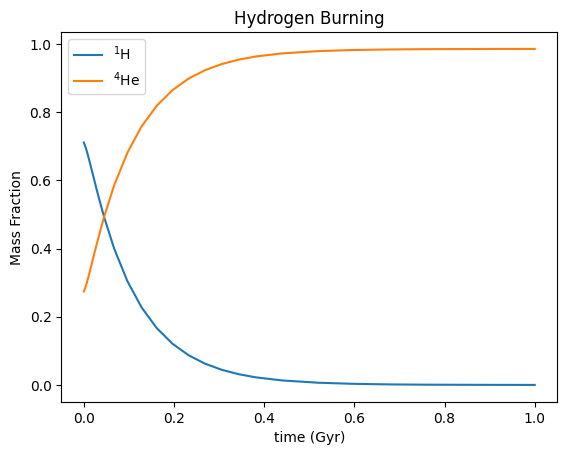

In [10]:
species = ['h1', 'he4']
h.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e16, xlabel='time (Gyr)',
                                  use_latex_names = True, title='Hydrogen Burning')

For sufficiently high temperature (such as appears in the cores of stars about 1.3 times as massive as the Sun), hydrogen burning occurs via [CNO cycling](https://en.wikipedia.org/wiki/CNO_cycle).  Cycles of reactions among isotopes of carbon, nitrogen, and oxygen catalyze the synthesis of $^4{\rm He}$ from $^{1}{\rm H}$.  Because of the cycling, the abundances of these isotopes come into a steady state such that the production equals destruction.  Because the temperature remains constant in the present model, the isotopes' abundance reach a constant value.

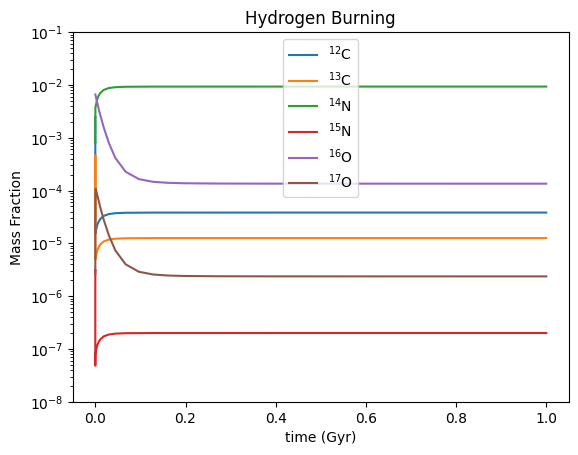

In [11]:
species = ['c12', 'c13', 'n14', 'n15', 'o16', 'o17']
h.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e16, xlabel='time (Gyr)', yscale = 'log',
                                  use_latex_names = True, title='Hydrogen Burning', ylim = [1.e-8,1.e-1])

<a id='helium'></a>
## Helium burning

Once the star exhausts its core hydrogen, it contracts and heats up.  Shell hydrogen burning ignites in the hydrogen-rich layers outside the hydrogen exhausted core.  This burning adds to the size of the helium-rich core.  Evenutally, helium burning ignites in the core.  For the present calculation, this burning stage was again modeled with constant temperature and density.  Read in the data and print the conditions for the calculation.

In [12]:
he = wx.Xml(model + '/he_burning/out.xml')
print_props(he)

For the calculation, the duration, temperature, and density were:
   time (yr) = 1.00e+04
   T (K) = 2.50e+08
   mass density (g/cc) = 1.50e+03


Helium burning occurs via the [triple-alpha process](https://en.wikipedia.org/wiki/Triple-alpha_process).  It creates $^{12}$C and $^{16}$O from the initial $^4$He.  The next cell graphs mass fractions during helium burning.  The default is to graph $^{4}{\rm He}$, $^{12}{\rm C}$, and $^{16}{\rm O}$.  Change the species and plot parameters according to your purposes.

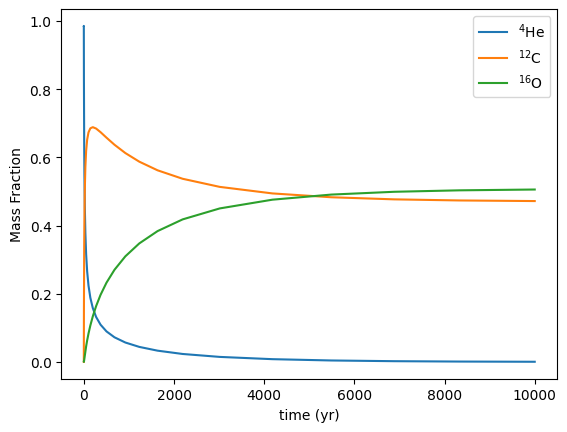

In [13]:
species = ['he4', 'c12', 'o16']
he.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e7, xlabel='time (yr)',
                                   use_latex_names = True)

Helium burning creates a carbon/oxygen core in the star.  If the core becomes [degenerate](https://en.wikipedia.org/wiki/Degenerate_matter#Degenerate_gases) at this stage, it is able to sustain itself against further gravitational contraction without further nuclear burning.  The reason is that radiation loss normally leads to a loss of energy from the core, which means the pressure decreases.  Nuclear burning releases energy and maintains the necessary pressure.  For degenerate matter, however, the pressure is simply maintained by the fact that no two electrons can exist in the same quantum mechanical state (the [Pauli exclusion principle](https://en.wikipedia.org/wiki/Pauli_exclusion_principle)).  At high density, this fact allows there to be strong pressure even at low temperature.



<a id='carbon'></a>
## Carbon burning

If the star can proceed past helium burning, it contracts, heats up, and ignites carbon.  Read the data and print the conditions for the calculation.

In [14]:
c = wx.Xml(model + '/c_burning/out.xml')
print_props(c)

For the calculation, the duration, temperature, and density were:
   time (yr) = 1.00e+04
   T (K) = 9.00e+08
   mass density (g/cc) = 1.50e+04


Carbon burning proceeds through two main reactions:  $^{12}{\rm C} + ^{12}{\rm C} \to ^{24}{\rm Mg} + \gamma$ and $^{12}{\rm C} + ^{12}{\rm C} \to ^{20}{\rm Ne} + ^4{\rm He}$.  Plot carbon burning abundances vs. time.  At the end of carbon burning, the mass fractions are dominated by $^{16}{\rm O}$, $^{20}{\rm Ne}$, and $^{24}{\rm Mg}$.  That is why stellar cores that become degenerate after carbon burning end up as ONeMg white dwarf stars.

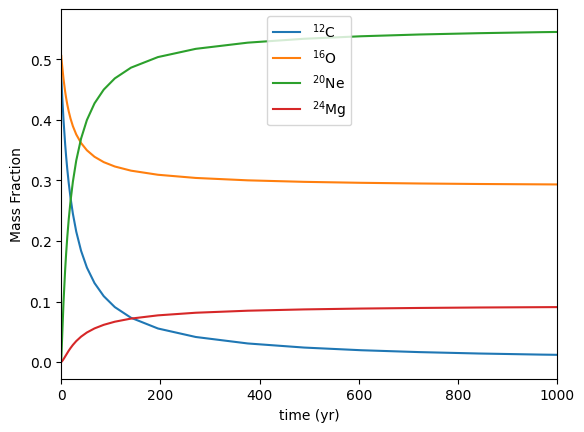

In [15]:
species = ['c12', 'o16', 'ne20', 'mg24']
c.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e7, xlabel='time (yr)', xlim = [0,1000],
                                   use_latex_names = True)

<a id='neon'></a>
## Neon burning

If a star proceeds past carbon burning, it contracts, heats up, and ignites neon.  Read the data and print the conditions for the present model.

In [16]:
ne = wx.Xml(model + '/ne_burning/out.xml')
print_props(ne)

For the calculation, the duration, temperature, and density were:
   time (yr) = 4.00e+02
   T (K) = 1.30e+09
   mass density (g/cc) = 1.50e+05


The main reaction in neon burning is $^{20}{\rm Ne} + ^{20}{\rm Ne} \to ^{16}{\rm O} + ^{24}{\rm Mg}$.  Effectively, a $^{4}{\rm He}$ transfers from one $^{20}{\rm Ne}$ to the other.  Alpha particle capture can also create heavier species like $^{28}{\rm Si}$.

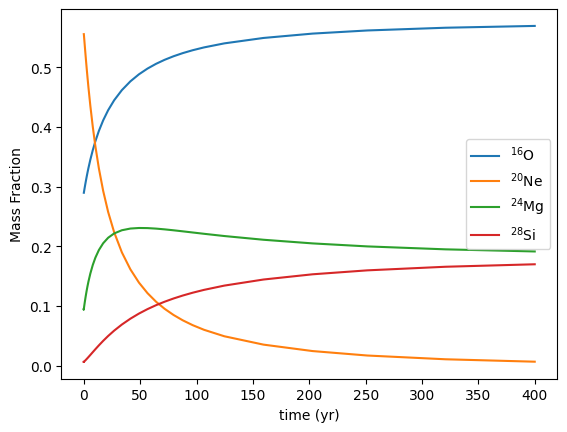

In [17]:
species = ['o16', 'ne20', 'mg24', 'si28']
ne.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e7, xlabel='time (yr)',
                                   use_latex_names = True)

<a id='oxygen'></a>
## Oxygen burning

The next burning stage is oxygen burning.  Read the data and print the conditions for the present mode.

In [18]:
o = wx.Xml(model + '/o_burning/out.xml')
print_props(o)

For the calculation, the duration, temperature, and density were:
   time (yr) = 1.00e+00
   T (K) = 2.10e+09
   mass density (g/cc) = 1.50e+06


The dominant reactions in oxygen buring are $^{16}{\rm O} + ^{16}{\rm O} \to ^{32}{\rm S} + \gamma$ and $^{16}{\rm O} + ^{16}{\rm O} \to ^{28}{\rm Si} + ^4{\rm He}$.

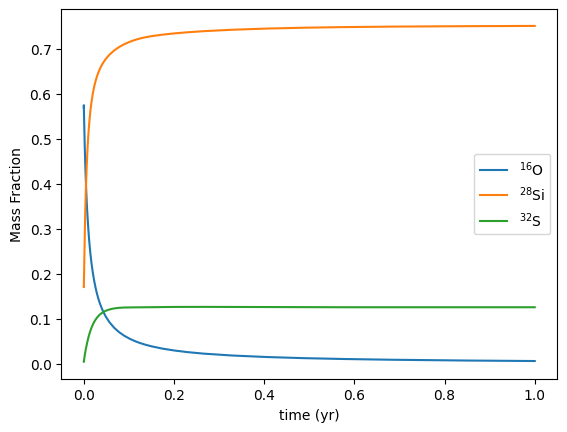

In [19]:
species = ['o16', 'si28', 's32']
o.plot_mass_fractions_vs_property('time', species, xfactor = 3.15e7, xlabel='time (yr)',
                                   use_latex_names = True)

Intriguingly, during oxygen burning, the high temperature and lack of light particles (nucleons and alpha particles) allows photo-disintegration reactions to be important.  This leads to [gamma-processing](https://en.wikipedia.org/wiki/P-nuclei#The_γ-process) in which heavy nuclei emit first neutrons then protons and alpha particles.  This causes the nuclei to break down to lighter species.  The light particles emitted during the gamma processing are captured by other, light nuclei.

Create an animation to show this processing.

In [20]:
ya = o.get_abundances_vs_nucleon_number(zone_xpath = "[position() = 1]")
my_extra = [(np.arange(len(ya[0])), ya[0], {'lw': 0.3, 'color': 'blue', 'label': 'Initial'})]

anim = o.make_abundances_vs_nucleon_number_movie(ylim = [1.e-14,1],
                                                    yscale = 'log',
                                                    xlim = [0,250], xlabel = 'Mass Number, A',
                                                    ylabel = 'Abundance per nucleon', extraFixedCurves=my_extra,
                                                    plotParams={'label': 'Current'},
                                                    legend={'loc': 'upper right'})

display(HTML(anim.to_jshtml()))
plt.close()

<a id='silicon'></a>
## Silicon burning

The final burning stage is silicon burning.  Read in the data and print the properties for the present model.

In [21]:
si = wx.Xml(model + '/si_burning/out.xml')
print_props(si)

For the calculation, the duration, temperature, and density were:
   time (yr) = 1.00e+00
   T (K) = 3.20e+09
   mass density (g/cc) = 1.50e+07


Silicon burning proceeds through a complex sequence of reactions in which disintegration reactions on some nuclei provide light particles for capture by other silicon nuclei.  The burning proceeds through a near equilibrium in which the "most fit" nuclei, that is, those with the highest binding energy per nucleon, become the most abundant.  These are the iron-group isotopes.

For the conditions in the default model, the burning is slow (not explosive).  This allows time for weak reactions to occur, which makes the matter neutron rich and allows species $^{54}{\rm Fe}$ and $^{56}{\rm Fe}$ to dominate the mass fractions.  In explosive nucleosynthesis, the burning is sufficiently fast that the weak reactions do not have time to occur and $^{56}{\rm Ni}$ is the most abundant species produced.

Plot species mass fractions vs. time in the model.

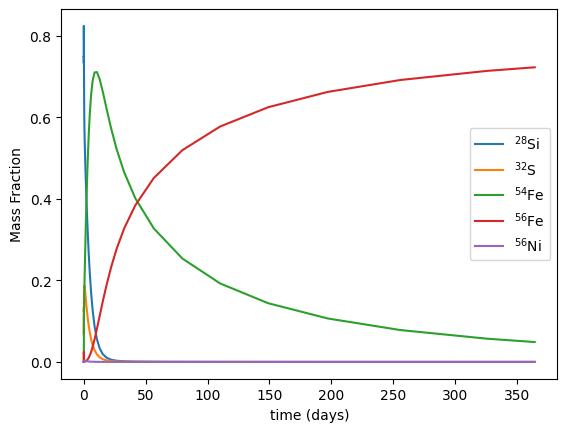

In [22]:
species = ['si28', 's32', 'fe54', 'fe56', 'ni56']
plt.close()
si.plot_mass_fractions_vs_property('time', species, xfactor = 8.64e4, xlabel='time (days)',
                                   use_latex_names = True)

The degree of neutron richness of nuclei can be characterized by the quantity $Y_e$, which is the number of electrons per nucleon.  For charge-neutral matter, this is the number of protons per nucleon.  $Y_e = 0.5$ would be matter with equal numbers of neutrons and protons.  Graph $Y_e$ vs. time to see how weak decays decrease $Y_e$ during silicon burning.

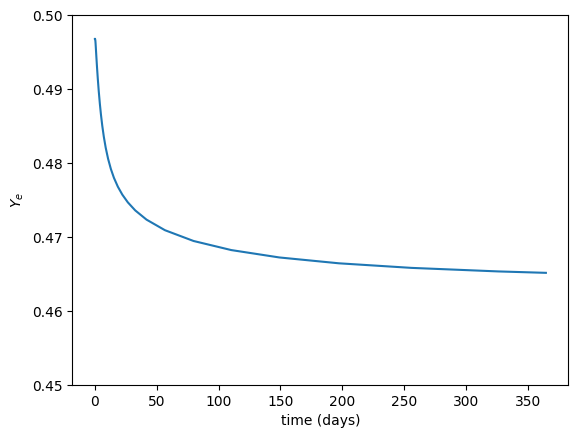

In [23]:
props = si.get_properties_as_floats(['time'])
y = si.get_all_abundances_in_zones()
ye = np.sum(np.dot(np.swapaxes(y, 1, 2), np.arange(y.shape[1])), axis=1)

plt.plot(props['time'] / 86400, ye)
plt.ylim([0.45,0.5])
plt.xlabel('time (days)')
plt.ylabel('$Y_e$')
plt.show()

Finally, create a movie to show the evolution of elemental abundances vs. time in the silicon burning model.

In [24]:
yz = si.get_abundances_vs_nucleon_number(nucleon = 'z', zone_xpath = "[position() = 1]")
my_extra = [(np.arange(len(yz[0])), yz[0], {'lw': 0.3, 'color': 'blue', 'label': 'Initial'})]

anim = si.make_abundances_vs_nucleon_number_movie(nucleon = 'z', ylim = [1.e-10,1],
                                                    yscale = 'log',
                                                    xlim = [0,50], xlabel = 'Atomic Number, Z',
                                                    ylabel = 'Abundance per nucleon', extraFixedCurves=my_extra,
                                                    plotParams={'label': 'Current'},
                                                    legend={'loc': 'upper right'})

display(HTML(anim.to_jshtml()))
plt.close()

Matter that has completed silicon burning has its nuclei arranged into the species with the maximum binding energy per nucleon.  Any rearrangement of those nucleons will require an input of energy rather than a release of it.  Nuclear energy is no longer available to the star, and energy losses leading to contraction result in a collapse of the stellar core known, appropriately enough, as a [core-collapse supernova](https://en.wikipedia.org/wiki/Type_II_supernova).

<a id='retrospective'></a>
# Retrospective

It is useful in retrospect to consider what the stellar burning stages do to the global properties $Y_e$ and the nuclear binding energy per nucleon.  First graph the electron fraction $Y_e$ at the beginning and end of each burning stage to see that hydrogen burning converts a significant fraction of all the neutrons present into protons but that the electron fraction does not subsequently change much again until silicon burning.  This latter result is due to the fact that it is only when nuclei reach the iron group that the stable isotopes are preferentially neutron rich.

In [ ]:
stages = [h, he, c, ne, o, si]
ye_initial, b_initial = stages_globals(stages, zone_xpath = "[position() = 1]")
ye_final, b_final = stages_globals(stages, zone_xpath = "[position() = last()]")

labels = ['H', 'He', 'C', 'Ne', 'O', 'Si']
x = np.arange(len(labels))
plt.plot(x, ye_initial, 'o-', label = 'initial')
plt.plot(x, ye_final, 'o-', label = 'final')
plt.xticks(x, labels)
plt.xlabel('Burning stage')
plt.ylabel('$Y_e$')
plt.legend()
plt.show()

Next graph the initial and final [nuclear binding energy](https://en.wikipedia.org/wiki/Nuclear_binding_energy) (in MeV, or millions of [electron volts](https://en.wikipedia.org/wiki/Electronvolt)) per nucleon in the burning stages.  The difference between the final and initial values gives the nuclear binding energy per nucleon released during the burning stage.  The binding energy of $^1{\rm H}$ is zero (since the those protons are not bound to any other nucleon).  The initial binding energy for hydrogen burning may not be zero because because the initial composition may include $^{4}{\rm He}$ and other nuclei that do have non-zero binding energy.

Most of the nuclear binding energy is released during hydrogen burning.  This helps explain why the hydrogen burning phase (the main sequence phase on the [Hertzsprung-Russell](https://en.wikipedia.org/wiki/Hertzsprung–Russell_diagram) diagram) is the longest in the star's lifetime.  As discussed above, once the star has completed silicon burning, no subsequent rearrangement of the nucleons releases nuclear binding energy and further evolution of the star leads to core collapse.

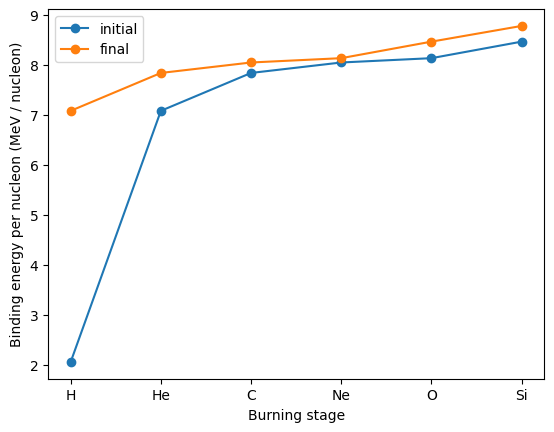

In [26]:
x = np.arange(len(labels))
plt.plot(x, b_initial, 'o-', label = 'initial')
plt.plot(x, b_final, 'o-', label = 'final')
plt.xticks(x, labels)
plt.xlabel('Burning stage')
plt.ylabel('Binding energy per nucleon (MeV / nucleon)')
plt.legend()
plt.show()